<a href="https://colab.research.google.com/github/TYH71/DELE_CA2/blob/main/Part%20C/I2I_pix2pix.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Case Study: Image-to-Image Translation with pix2pix

In [1]:
# import libraries
import tensorflow as tf

import os
import pathlib
import time
import datetime

from matplotlib import pyplot as plt
from IPython import display

# matplotlib stylings
plt.rcParams['figure.figsize'] = 16, 9

# Load the dataset

In order to demonstrate the prowess of image to image translation, I will be using the `cityscape` dataset sourced from UC Berkeley repository. The dataset comes as a set of real images and a semantic segmented version of it, with urban streets as the main focus. The objective of the GAN model is to translate a semantic segmented image into a realistic urban street image.

![](https://storage.googleapis.com/kaggle-datasets-images/22655/29047/a383c2a76bec36a0537130d8c83e2527/data-original.jpg?t=2018-04-20-14-28-00)

In [2]:
dataset_name = "cityscapes"

_URL = f'http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/{dataset_name}.tar.gz'

path_to_zip = tf.keras.utils.get_file(
    fname=f"{dataset_name}.tar.gz",
    origin=_URL,
    extract=True)

path_to_zip  = pathlib.Path(path_to_zip)

PATH = path_to_zip.parent/dataset_name

103456768/103441232 [==============================] - 50s 0us/step


In [3]:
list(PATH.parent.iterdir())

[PosixPath('/root/.keras/datasets/cityscapes.tar.gz'),
 PosixPath('/root/.keras/datasets/cityscapes')]

In [4]:
sample_image = tf.io.read_file(str(PATH / 'train/1.jpg'))
sample_image = tf.io.decode_jpeg(sample_image)
print(sample_image.shape)

(256, 512, 3)


Each original image is of size 256 by 512, containing two images of 256 by 256.

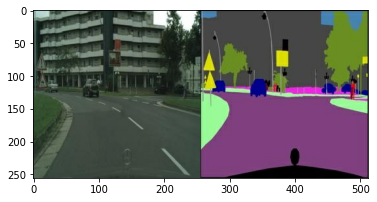

In [5]:
plt.figure()
plt.imshow(sample_image)
plt.show()

In [6]:
def load(image_file):
    # Read and decode an image file to a uint8 tensor
    image = tf.io.read_file(image_file)
    image = tf.io.decode_jpeg(image)

    # Split each image tensor into two tensors:
    # - one with a real building facade image
    # - one with an architecture label image 
    w = tf.shape(image)[1]
    w = w // 2
    input_image = image[:, w:, :]
    real_image = image[:, :w, :]

    # Convert both images to float32 tensors
    input_image = tf.cast(input_image, tf.float32)
    real_image = tf.cast(real_image, tf.float32)

    return input_image, real_image

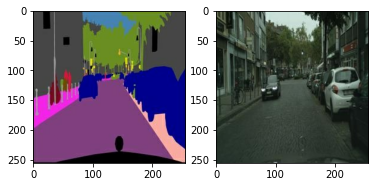

In [7]:
inp, re = load(str(PATH / 'train/100.jpg'))
# Casting to int for matplotlib to display the images
fig, (ax1, ax2) = plt.subplots(1, 2)
ax1.imshow(inp / 255.0)
ax2.imshow(re / 255.0)
plt.show()

According to the pix2pix paper, some augmentation is done to preprocess the training set, these comes as random jittering and mirroring.



In [8]:
# The facade training set consist of 400 images
BUFFER_SIZE = 400
# The batch size of 1 produced better results for the U-Net in the original pix2pix experiment
BATCH_SIZE = 1
# Each image is 256x256 in size
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [9]:
def resize(input_image, real_image, height, width):
    input_image = tf.image.resize(input_image, [height, width], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    real_image = tf.image.resize(real_image, [height, width], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

    return input_image, real_image

In [10]:
def random_crop(input_image, real_image):
    stacked_image = tf.stack([input_image, real_image], axis=0)
    cropped_image = tf.image.random_crop(stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])

    return cropped_image[0], cropped_image[1]

In [11]:
# Normalizing the images to [-1, 1]
def normalize(input_image, real_image):
    input_image = (input_image / 127.5) - 1
    real_image = (real_image / 127.5) - 1

    return input_image, real_image

In [12]:
@tf.function()
def random_jitter(input_image, real_image):
    # Resizing to 286x286
    input_image, real_image = resize(input_image, real_image, 286, 286)

    # Random cropping back to 256x256
    input_image, real_image = random_crop(input_image, real_image)

    if tf.random.uniform(()) > 0.5:
        # Random mirroring
        input_image = tf.image.flip_left_right(input_image)
        real_image = tf.image.flip_left_right(real_image)

    return input_image, real_image

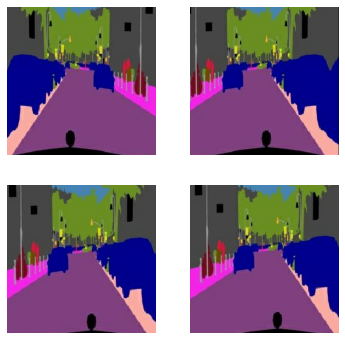

In [13]:
plt.figure(figsize=(6, 6))
for i in range(4):
    rj_inp, rj_re = random_jitter(inp, re)
    plt.subplot(2, 2, i + 1)
    plt.imshow(rj_inp / 255.0)
    plt.axis('off')
plt.show()

In [14]:
def load_image_train(image_file):
    input_image, real_image = load(image_file)
    input_image, real_image = random_jitter(input_image, real_image)
    input_image, real_image = normalize(input_image, real_image)

    return input_image, real_image

In [15]:
def load_image_test(image_file):
    input_image, real_image = load(image_file)
    input_image, real_image = resize(input_image, real_image,
                                    IMG_HEIGHT, IMG_WIDTH)
    input_image, real_image = normalize(input_image, real_image)

    return input_image, real_image

In [16]:
# building the training dataset
train_dataset = tf.data.Dataset.list_files(str(PATH / 'train/*.jpg'))
train_dataset = train_dataset.map(load_image_train, num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

In [17]:
# building the testing dataset
try:
    test_dataset = tf.data.Dataset.list_files(str(PATH / 'test/*.jpg'))
except tf.errors.InvalidArgumentError:
    test_dataset = tf.data.Dataset.list_files(str(PATH / 'val/*.jpg'))
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

# U-Net Generator

In [18]:
OUTPUT_CHANNELS = 3

In [19]:
def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                kernel_initializer=initializer, use_bias=False))

    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())

    result.add(tf.keras.layers.LeakyReLU())

    return result

In [20]:
def upsample(filters, size, apply_dropout=False):
    # Gaussian Weight Initialization
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                        padding='same',
                                        kernel_initializer=initializer,
                                        use_bias=False))

    result.add(tf.keras.layers.BatchNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.SpatialDropout2D(0.5))

    result.add(tf.keras.layers.ReLU())

    return result

In [21]:
def Generator():
    inputs = tf.keras.layers.Input(shape=[256, 256, 3])

    down_stack = [
        downsample(64, 4, apply_batchnorm=False),  # (batch_size, 128, 128, 64)
        downsample(128, 4),  # (batch_size, 64, 64, 128)
        downsample(256, 4),  # (batch_size, 32, 32, 256)
        downsample(512, 4),  # (batch_size, 16, 16, 512)
        downsample(512, 4),  # (batch_size, 8, 8, 512)
        downsample(512, 4),  # (batch_size, 4, 4, 512)
        downsample(512, 4),  # (batch_size, 2, 2, 512)
        downsample(512, 4),  # (batch_size, 1, 1, 512)
    ]

    up_stack = [
        upsample(512, 4, apply_dropout=True),  # (batch_size, 2, 2, 1024)
        upsample(512, 4, apply_dropout=True),  # (batch_size, 4, 4, 1024)
        upsample(512, 4, apply_dropout=True),  # (batch_size, 8, 8, 1024)
        upsample(512, 4),  # (batch_size, 16, 16, 1024)
        upsample(256, 4),  # (batch_size, 32, 32, 512)
        upsample(128, 4),  # (batch_size, 64, 64, 256)
        upsample(64, 4),  # (batch_size, 128, 128, 128)
    ]

    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                            strides=2,
                                            padding='same',
                                            kernel_initializer=initializer,
                                            activation='tanh')  # (batch_size, 256, 256, 3)

    x = inputs

    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)

    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = tf.keras.layers.Concatenate()([x, skip])

    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)

In [22]:
generator = Generator()
generator.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 128, 128, 64  3072        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 sequential_1 (Sequential)      (None, 64, 64, 128)  131584      ['sequential[0][0]']             
                                                                                              

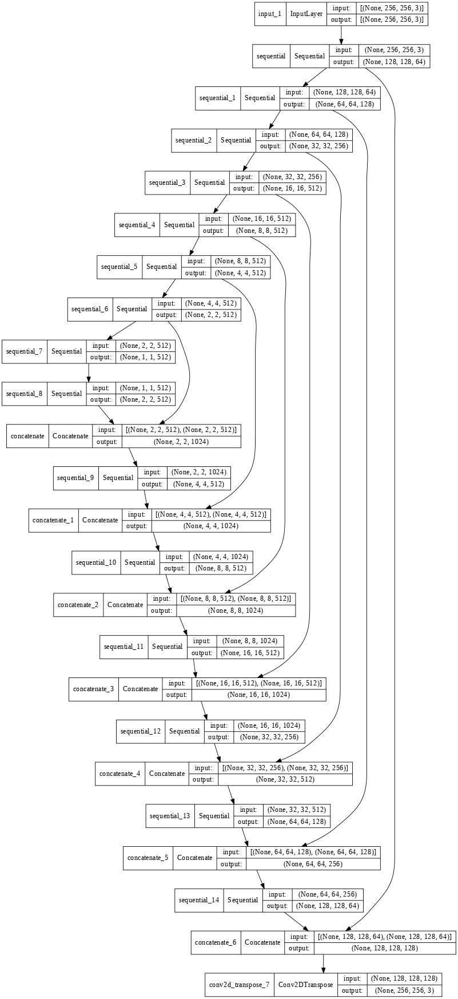

In [23]:
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

## Generator Loss

In [24]:
LAMBDA = 100

In [25]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [26]:
def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

    # Mean absolute error
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

    total_gen_loss = gan_loss + (LAMBDA * l1_loss)

    return total_gen_loss, gan_loss, l1_loss

# Discriminator


In [27]:
def Discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)

    inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
    tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

    x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

    down1 = downsample(64, 4, False)(x)  # (batch_size, 128, 128, 64)
    down2 = downsample(128, 4)(down1)  # (batch_size, 64, 64, 128)
    down3 = downsample(256, 4)(down2)  # (batch_size, 32, 32, 256)

    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (batch_size, 34, 34, 256)
    conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                    kernel_initializer=initializer,
                                    use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

    batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

    leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

    last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                    kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

    return tf.keras.Model(inputs=[inp, tar], outputs=last)

In [28]:
discriminator = Discriminator()
discriminator.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_image (InputLayer)       [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 target_image (InputLayer)      [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 concatenate_7 (Concatenate)    (None, 256, 256, 6)  0           ['input_image[0][0]',            
                                                                  'target_image[0][0]']     

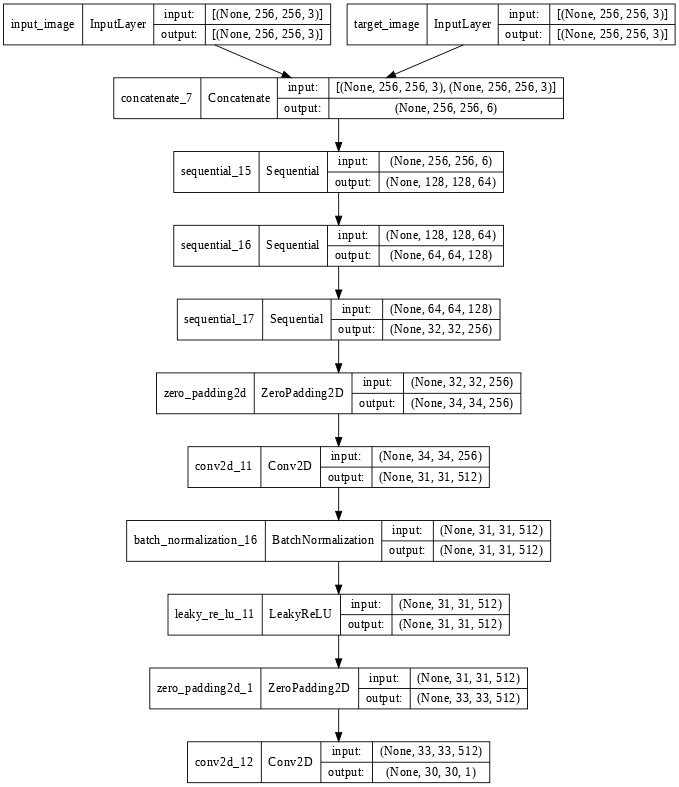

In [29]:
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

## Discriminator Loss

In [30]:
def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

    generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

    total_disc_loss = real_loss + generated_loss

    return total_disc_loss

# Optimizers and Callback Functions

In [31]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [32]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [33]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

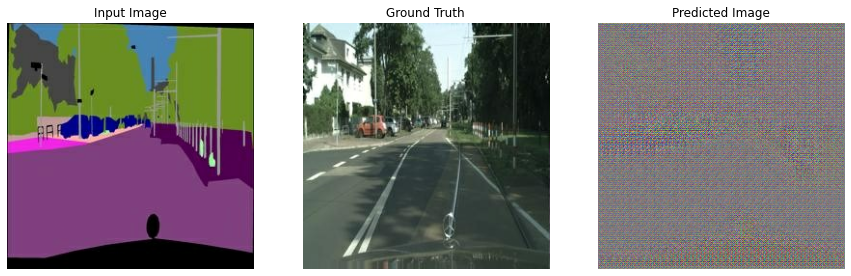

In [34]:
for example_input, example_target in test_dataset.take(1):
    generate_images(generator, example_input, example_target)

# Training Functions

In [35]:
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [36]:
@tf.function
def train_step(input_image, target, step):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = generator(input_image, training=True)

        disc_real_output = discriminator([input_image, target], training=True)
        disc_generated_output = discriminator([input_image, gen_output], training=True)

        gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

    # computes gradient over loss function
    generator_gradients = gen_tape.gradient(gen_total_loss,
                                            generator.trainable_variables)
    discriminator_gradients = disc_tape.gradient(disc_loss,
                                                discriminator.trainable_variables)

    # update gradients
    generator_optimizer.apply_gradients(zip(generator_gradients,
                                            generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                                discriminator.trainable_variables))

    with summary_writer.as_default():
        tf.summary.scalar('gen_total_loss', gen_total_loss, step=step//1000)
        tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=step//1000)
        tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=step//1000)
        tf.summary.scalar('disc_loss', disc_loss, step=step//1000)

In [37]:
def fit(train_ds, test_ds, steps):
    example_input, example_target = next(iter(test_ds.take(1)))
    start = time.time()

    for step, (input_image, target) in train_ds.repeat().take(steps).enumerate():
        if (step) % 1000 == 0:
            # display.clear_output(wait=True)

            if step != 0:
                print(f'Time taken for 1000 steps: {time.time()-start:.2f} sec\n')

            start = time.time()

            generate_images(generator, example_input, example_target)
            print(f"Step: {step//1000}k")

        train_step(input_image, target, step)

        # Training step
        if (step+1) % 10 == 0:
            print('.', end='', flush=True)

        # Save (checkpoint) the model every 5k steps
        if (step + 1) % 5000 == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)


In [38]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

<IPython.core.display.Javascript object>

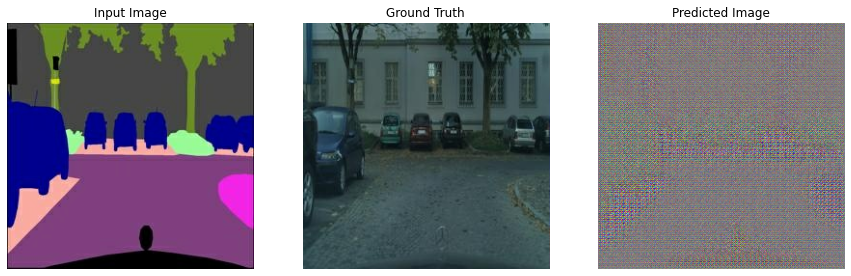

Step: 0k
....................................................................................................Time taken for 1000 steps: 53.96 sec



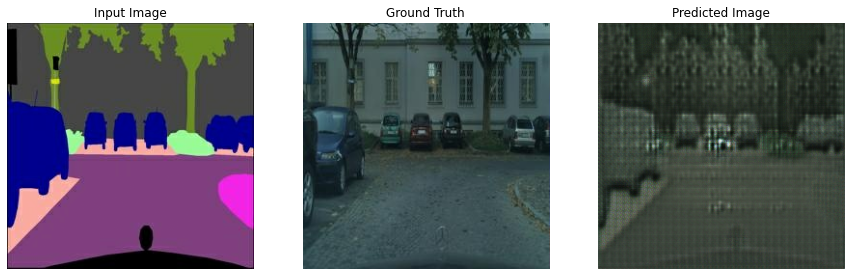

Step: 1k
....................................................................................................Time taken for 1000 steps: 50.88 sec



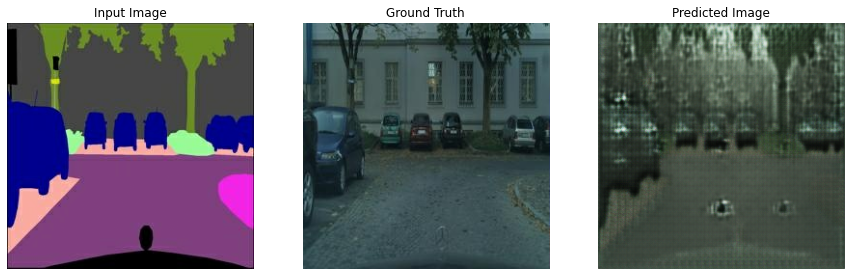

Step: 2k
....................................................................................................Time taken for 1000 steps: 51.62 sec



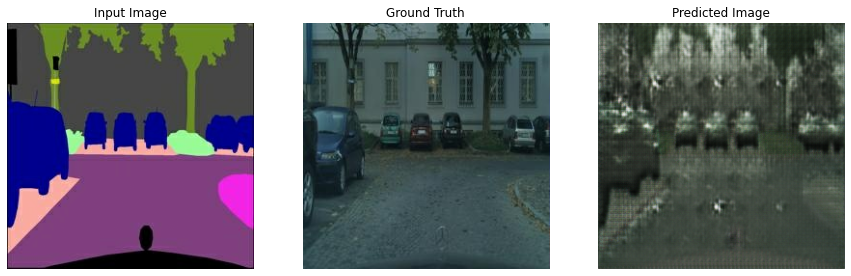

Step: 3k
....................................................................................................Time taken for 1000 steps: 50.83 sec



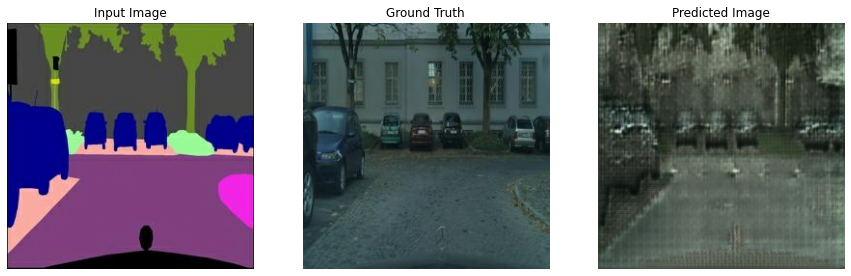

Step: 4k
....................................................................................................Time taken for 1000 steps: 52.70 sec



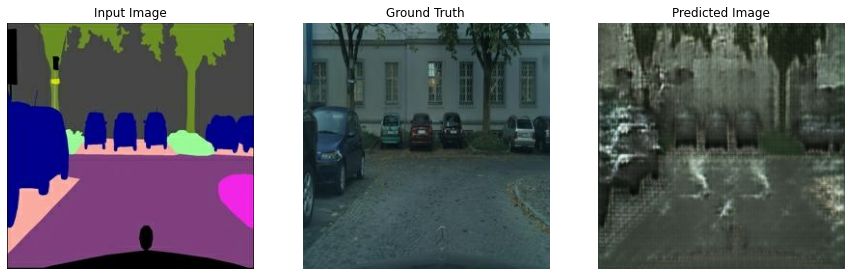

Step: 5k
....................................................................................................Time taken for 1000 steps: 51.57 sec



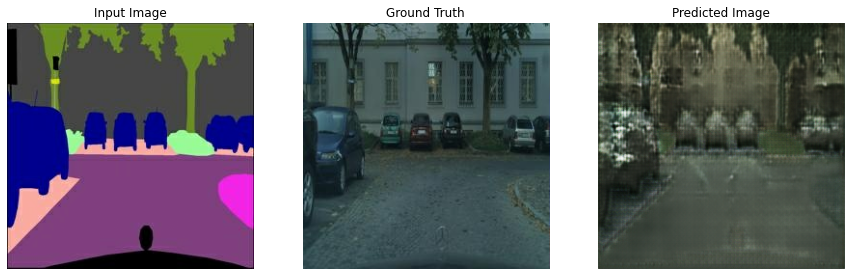

Step: 6k
....................................................................................................Time taken for 1000 steps: 50.87 sec



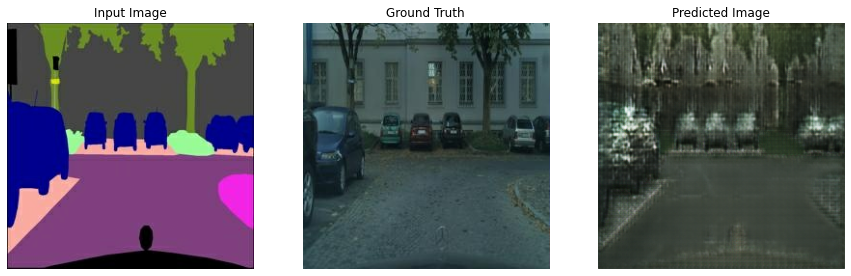

Step: 7k
....................................................................................................Time taken for 1000 steps: 50.90 sec



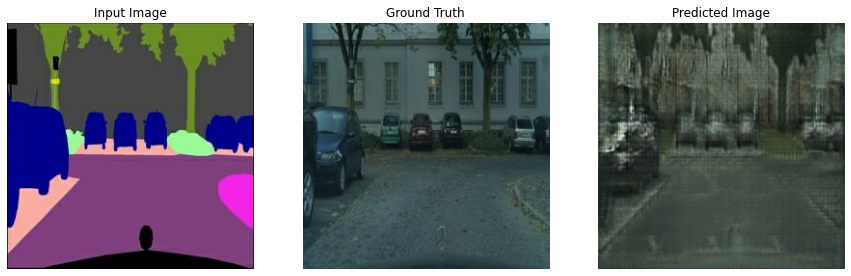

Step: 8k
....................................................................................................Time taken for 1000 steps: 51.65 sec



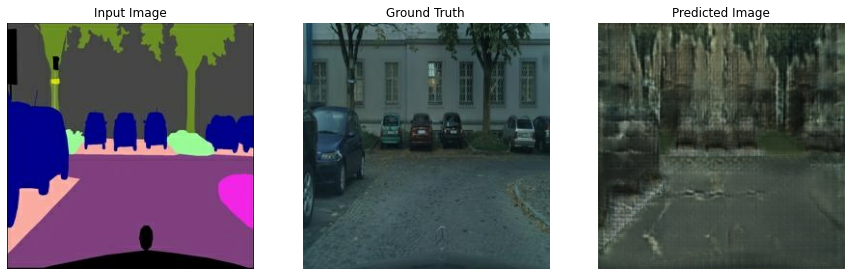

Step: 9k
....................................................................................................Time taken for 1000 steps: 52.46 sec



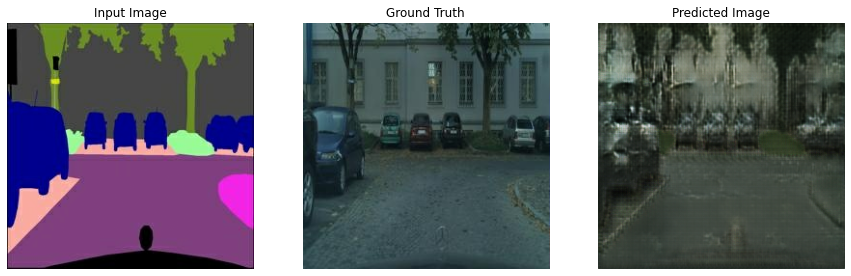

Step: 10k
....................................................................................................Time taken for 1000 steps: 50.89 sec



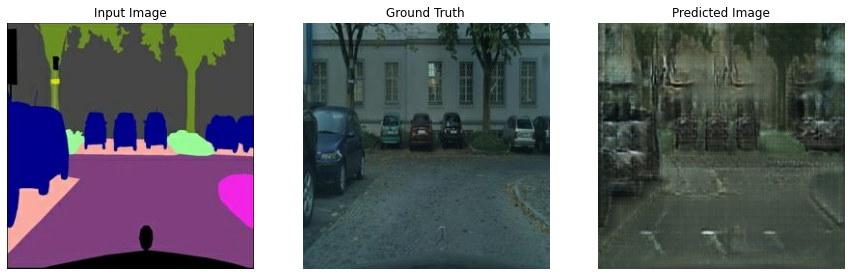

Step: 11k
....................................................................................................Time taken for 1000 steps: 51.42 sec



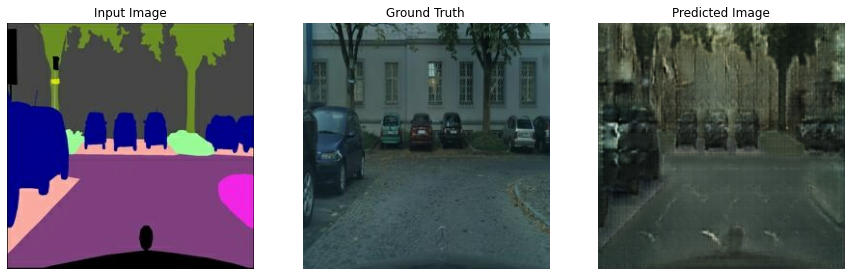

Step: 12k
....................................................................................................Time taken for 1000 steps: 50.85 sec



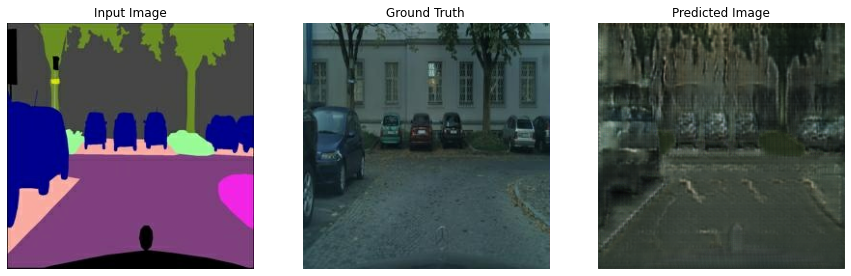

Step: 13k
....................................................................................................Time taken for 1000 steps: 50.96 sec



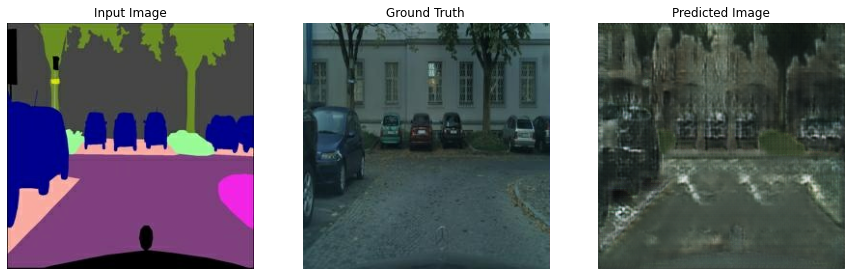

Step: 14k
....................................................................................................Time taken for 1000 steps: 53.10 sec



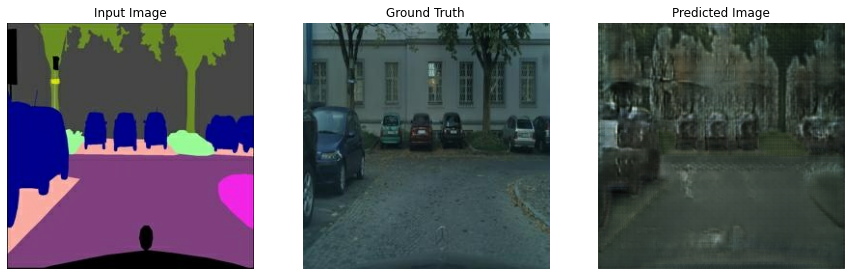

Step: 15k
....................................................................................................Time taken for 1000 steps: 50.75 sec



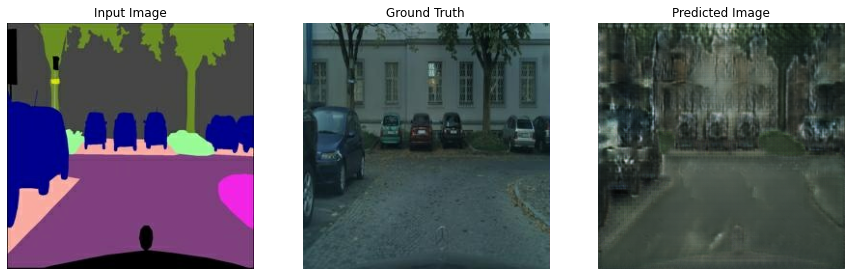

Step: 16k
....................................................................................................Time taken for 1000 steps: 50.83 sec



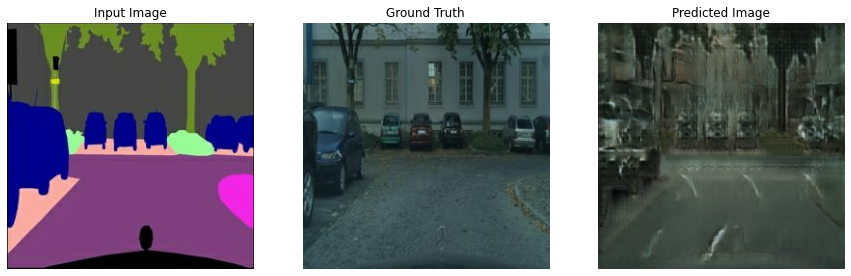

Step: 17k
....................................................................................................Time taken for 1000 steps: 51.54 sec



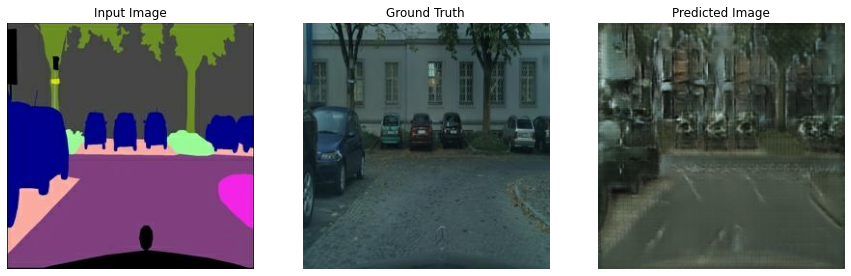

Step: 18k
....................................................................................................Time taken for 1000 steps: 50.82 sec



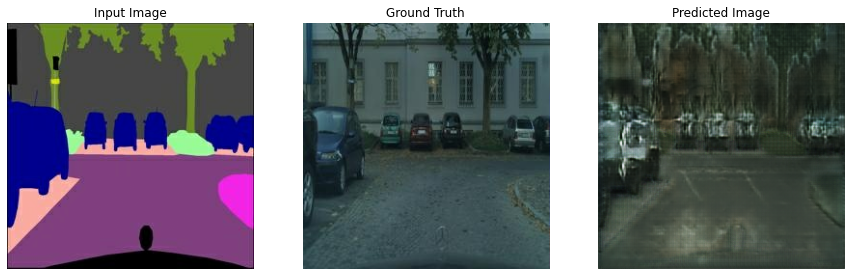

Step: 19k
....................................................................................................Time taken for 1000 steps: 52.61 sec



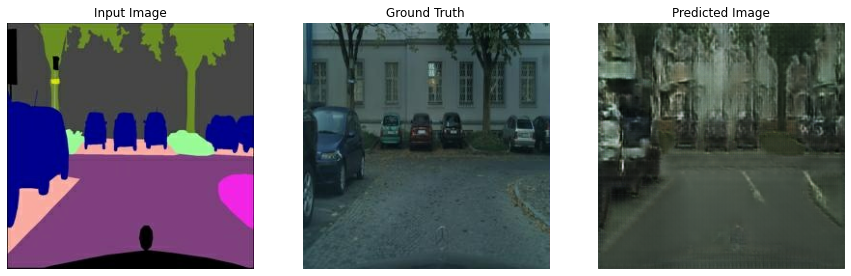

Step: 20k
....................................................................................................Time taken for 1000 steps: 51.58 sec



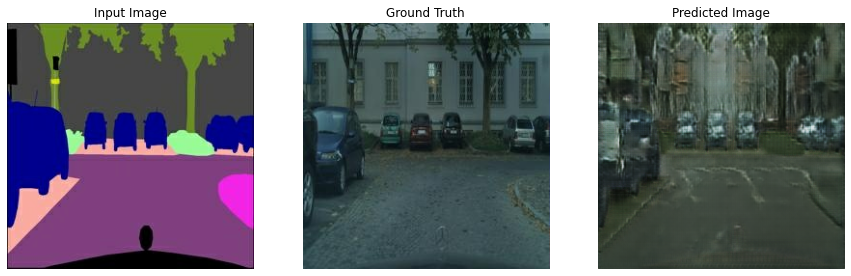

Step: 21k
....................................................................................................Time taken for 1000 steps: 50.88 sec



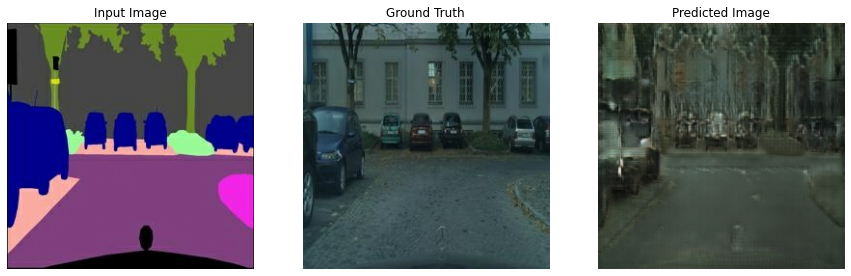

Step: 22k
....................................................................................................Time taken for 1000 steps: 50.81 sec



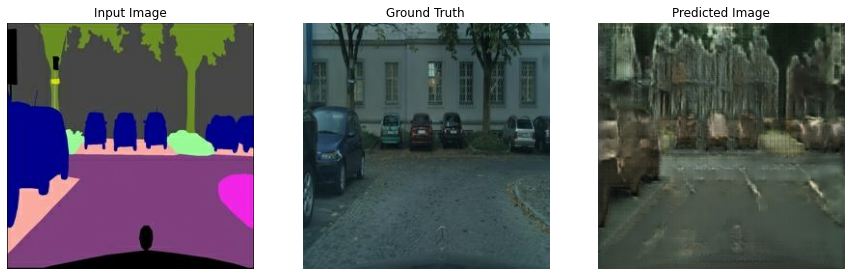

Step: 23k
....................................................................................................Time taken for 1000 steps: 51.68 sec



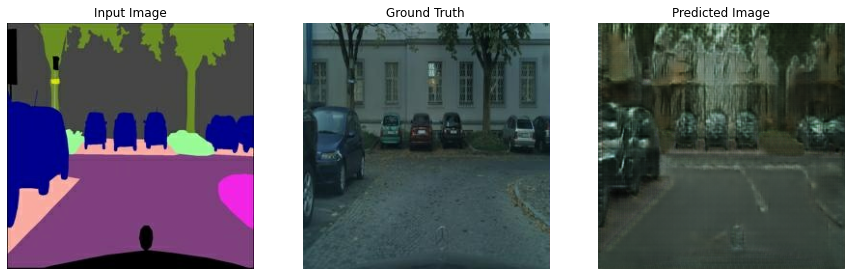

Step: 24k
....................................................................................................Time taken for 1000 steps: 52.28 sec



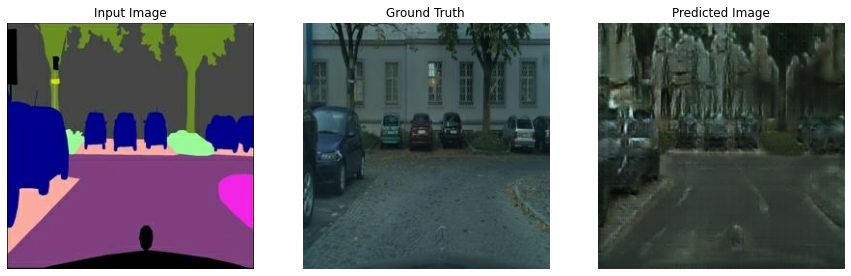

Step: 25k
....................................................................................................Time taken for 1000 steps: 50.85 sec



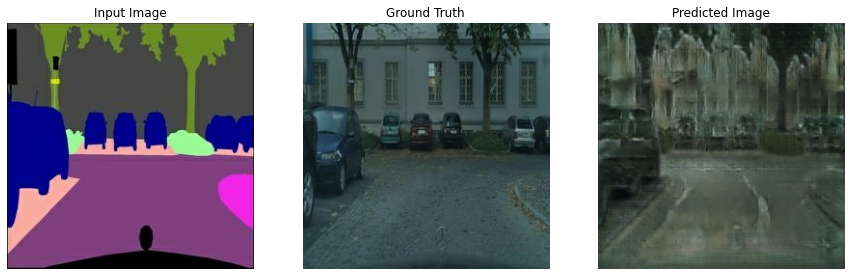

Step: 26k
....................................................................................................Time taken for 1000 steps: 51.45 sec



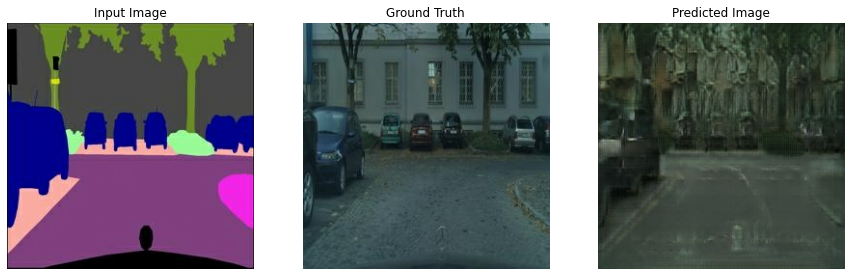

Step: 27k
....................................................................................................Time taken for 1000 steps: 50.86 sec



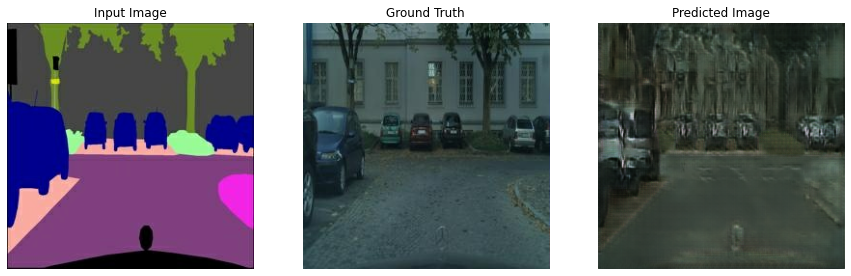

Step: 28k
....................................................................................................Time taken for 1000 steps: 50.79 sec



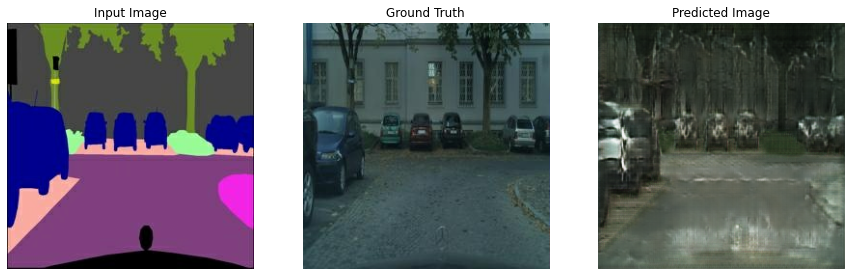

Step: 29k
....................................................................................................Time taken for 1000 steps: 53.04 sec



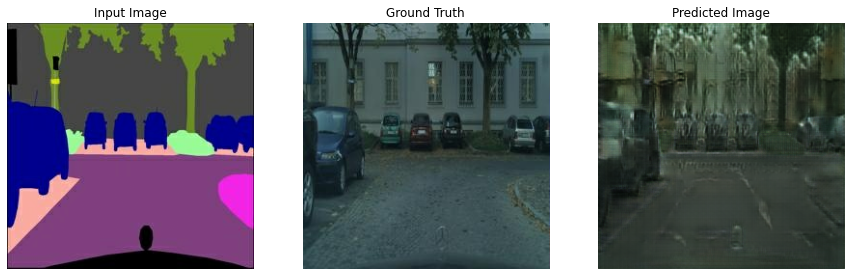

Step: 30k
....................................................................................................Time taken for 1000 steps: 50.87 sec



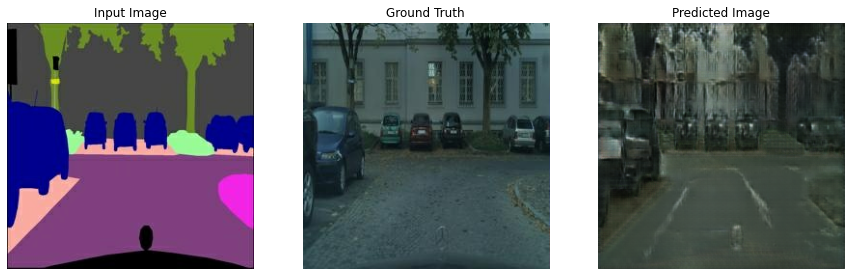

Step: 31k
....................................................................................................Time taken for 1000 steps: 50.81 sec



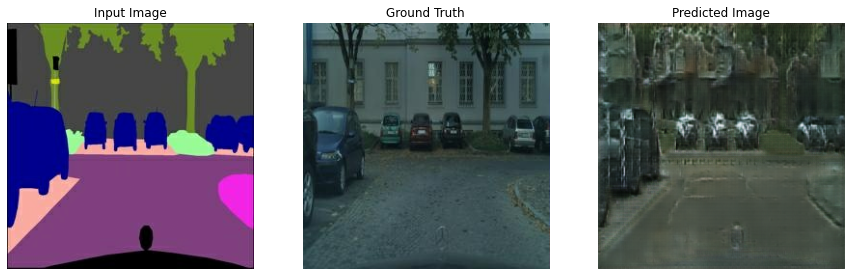

Step: 32k
....................................................................................................Time taken for 1000 steps: 51.66 sec



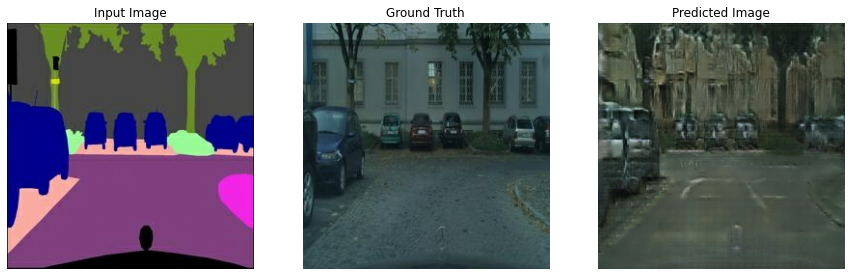

Step: 33k
....................................................................................................Time taken for 1000 steps: 50.93 sec



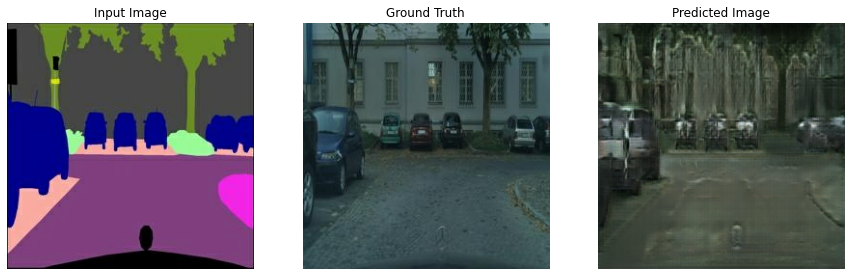

Step: 34k
....................................................................................................Time taken for 1000 steps: 52.56 sec



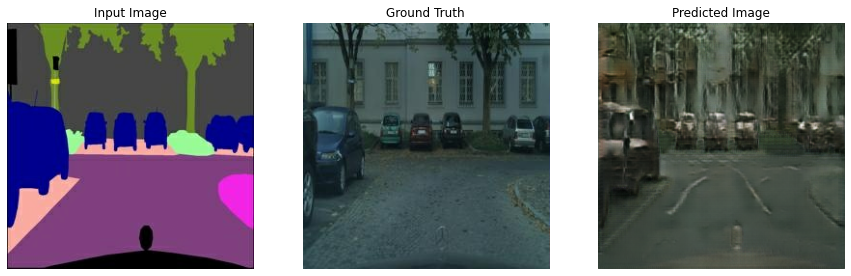

Step: 35k
....................................................................................................Time taken for 1000 steps: 51.59 sec



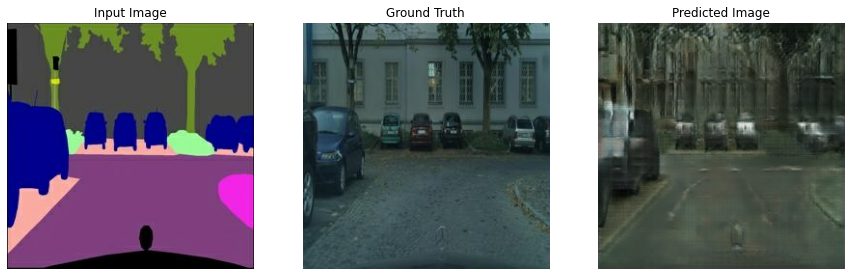

Step: 36k
....................................................................................................Time taken for 1000 steps: 50.85 sec



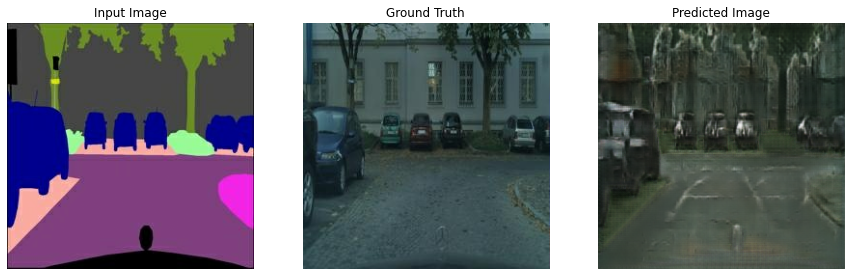

Step: 37k
....................................................................................................Time taken for 1000 steps: 50.90 sec



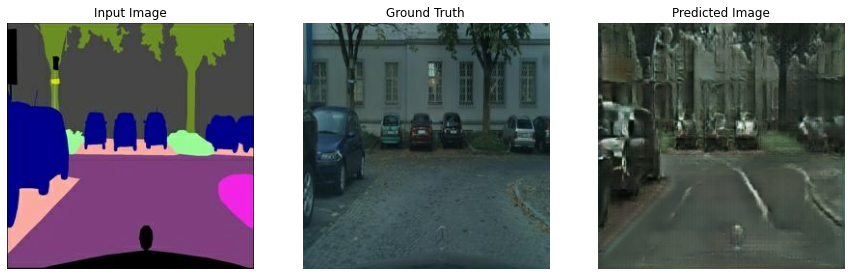

Step: 38k
....................................................................................................Time taken for 1000 steps: 51.74 sec



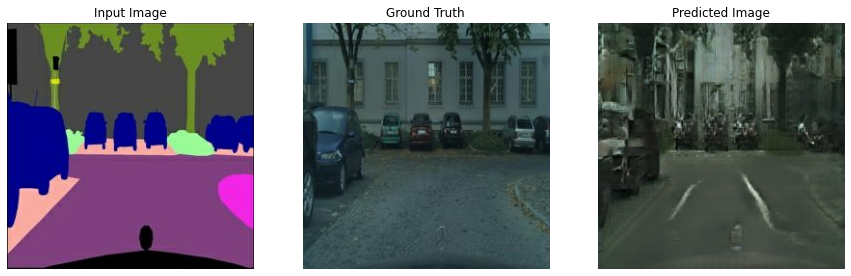

Step: 39k
....................................................................................................Time taken for 1000 steps: 52.16 sec



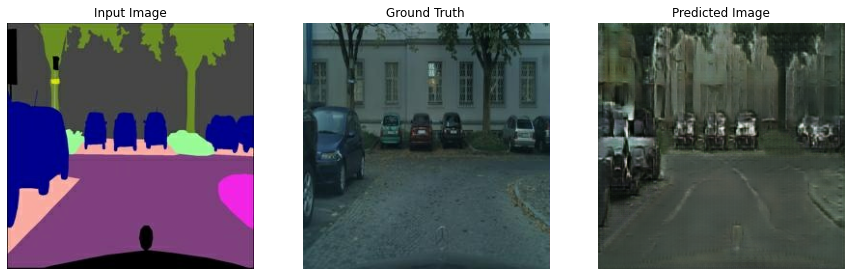

Step: 40k
....................................................................................................Time taken for 1000 steps: 50.90 sec



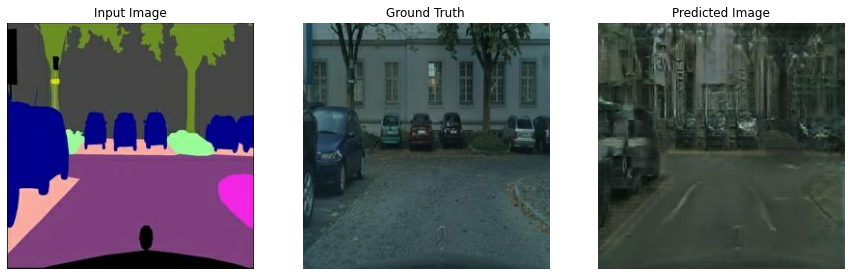

Step: 41k
....................................................................................................Time taken for 1000 steps: 51.61 sec



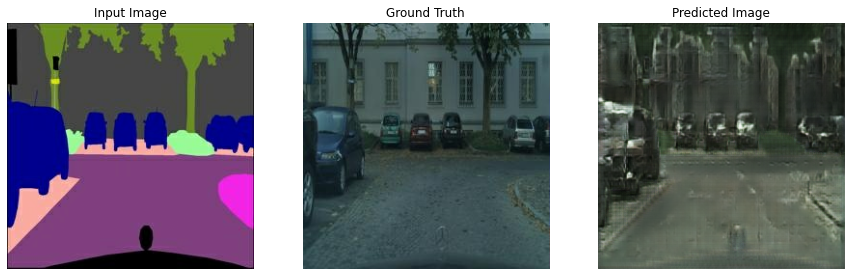

Step: 42k
....................................................................................................Time taken for 1000 steps: 50.91 sec



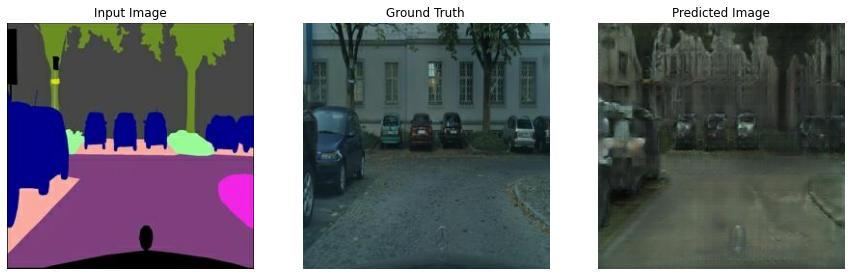

Step: 43k
....................................................................................................Time taken for 1000 steps: 50.90 sec



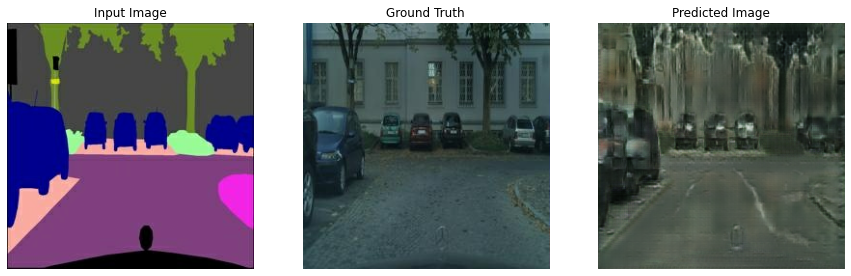

Step: 44k
....................................................................................................Time taken for 1000 steps: 53.30 sec



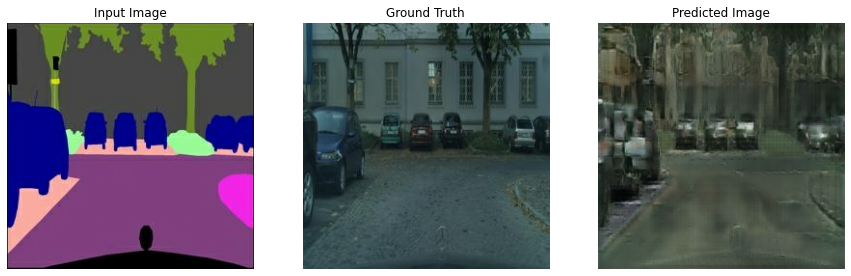

Step: 45k
....................................................................................................Time taken for 1000 steps: 50.94 sec



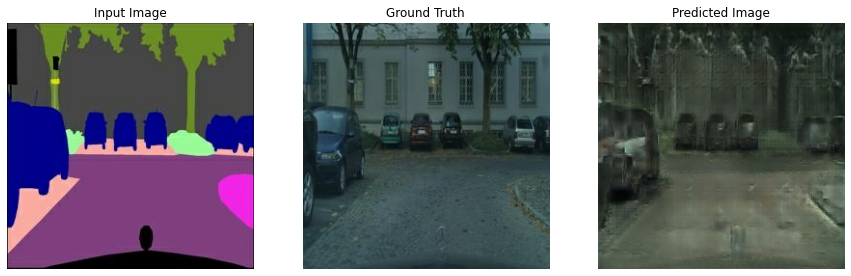

Step: 46k
....................................................................................................Time taken for 1000 steps: 50.93 sec



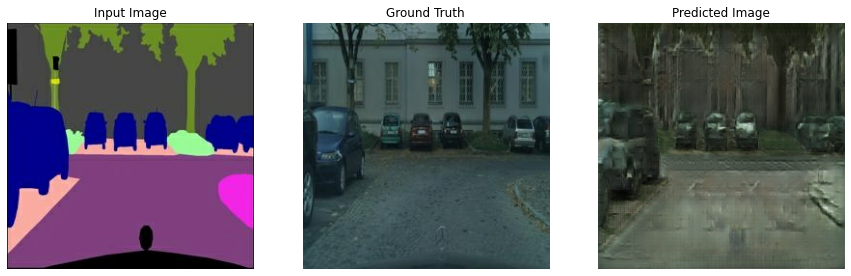

Step: 47k
....................................................................................................Time taken for 1000 steps: 51.80 sec



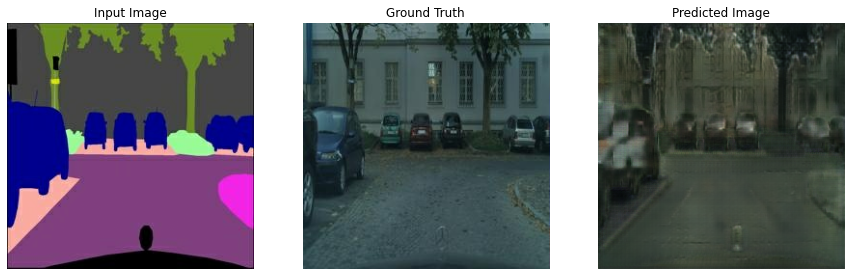

Step: 48k
....................................................................................................Time taken for 1000 steps: 50.98 sec



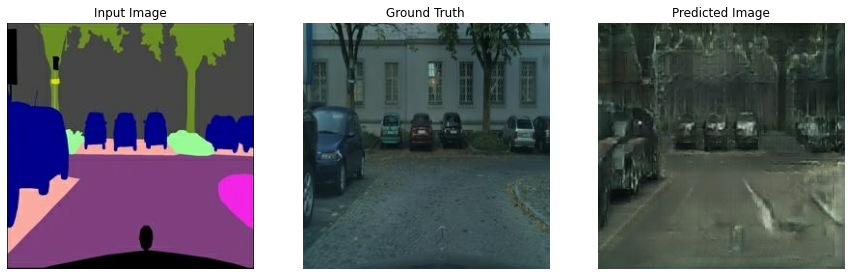

Step: 49k
....................................................................................................CPU times: user 27min 50s, sys: 1min 41s, total: 29min 31s
Wall time: 42min 55s


In [39]:
%%time
fit(train_dataset, test_dataset, steps=50000)

In [40]:
display.IFrame(
    src="https://tensorboard.dev/experiment/lZ0C6FONROaUMfjYkVyJqw",
    width="100%",
    height="1000px")

In [41]:
!ls {checkpoint_dir}

checkpoint		     ckpt-5.data-00000-of-00001
ckpt-10.data-00000-of-00001  ckpt-5.index
ckpt-10.index		     ckpt-6.data-00000-of-00001
ckpt-1.data-00000-of-00001   ckpt-6.index
ckpt-1.index		     ckpt-7.data-00000-of-00001
ckpt-2.data-00000-of-00001   ckpt-7.index
ckpt-2.index		     ckpt-8.data-00000-of-00001
ckpt-3.data-00000-of-00001   ckpt-8.index
ckpt-3.index		     ckpt-9.data-00000-of-00001
ckpt-4.data-00000-of-00001   ckpt-9.index
ckpt-4.index


In [42]:
# Restoring the latest checkpoint in checkpoint_dir
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

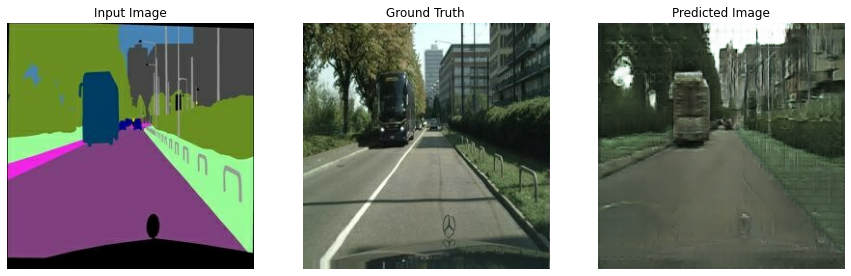

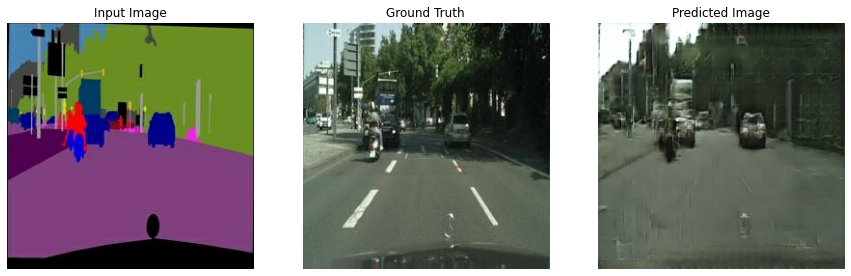

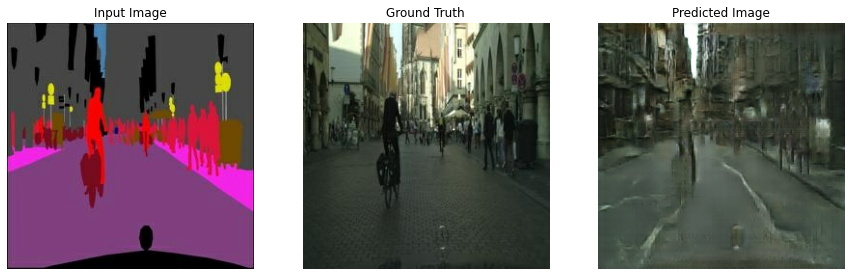

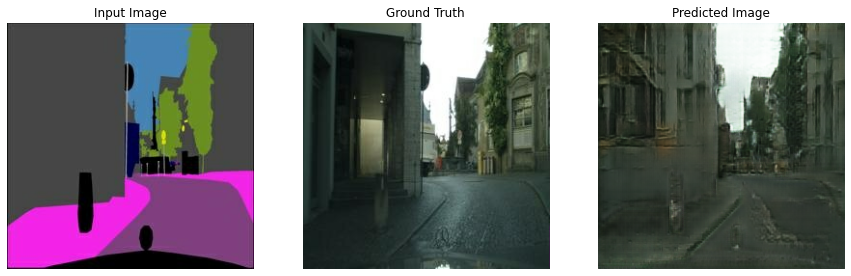

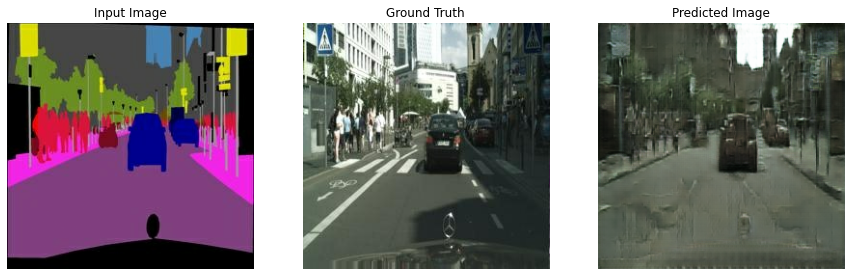

...

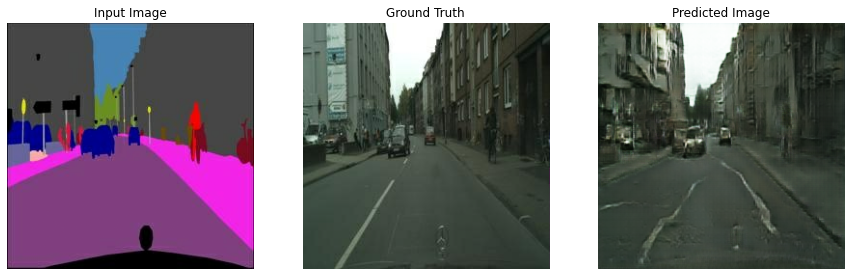

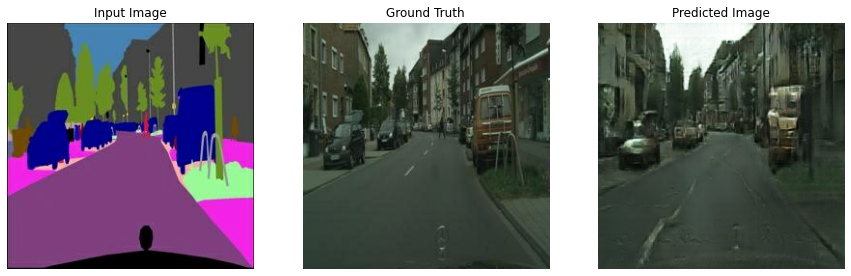

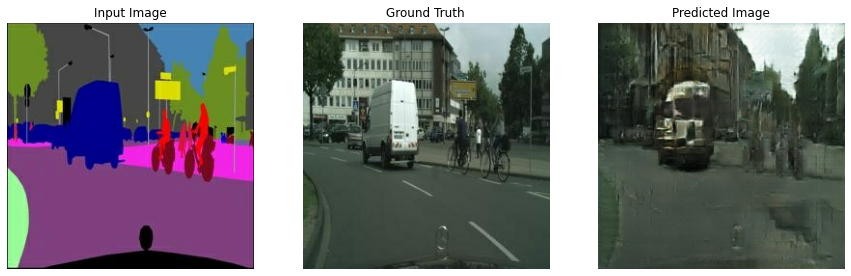

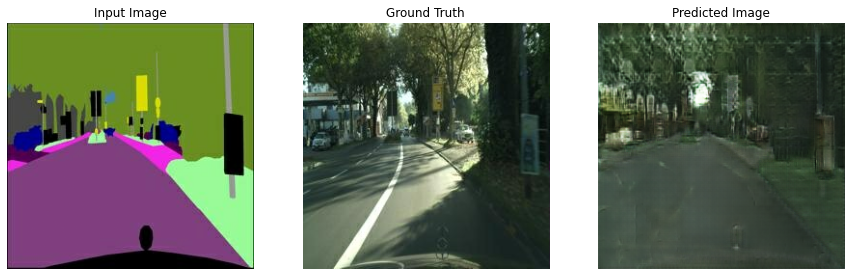

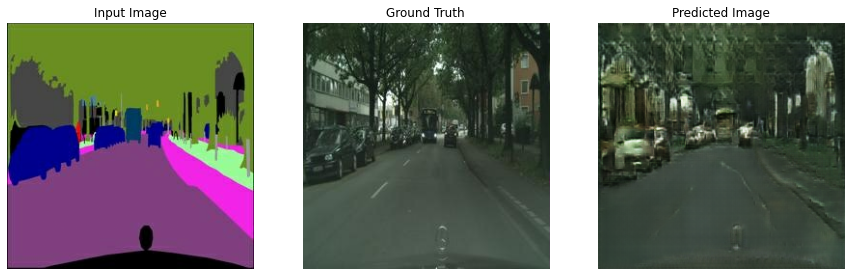

In [43]:
# Run the trained model on a few examples from the test set
for inp, tar in test_dataset.take(15):
    generate_images(generator, inp, tar)